<a href="https://colab.research.google.com/github/HyunJin-developer/OpenCv-python/blob/main/OpenCV_Chap6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Chap 6. 영상 필터
먼저 영상 처리란, 새로운 영상을 얻기 위해 기존 픽셀 값에 어떠한 연산을 가해서 새로운 픽셀 값을 얻는 작업이다.   
- 공간 영역 필터(spacial domain filter) : 기존 픽셀 값 하나가 아닌 그 픽셀과 주변 픽셀들의 값을 활용하는 방법
- 주파수 영역 필터(frequency domain filter) : 픽셀 값들의 차이를 주파수로 변환해서 활용하는 방법

## 6.1 컨볼루션과 블러링
- 컨볼루션(convolution) : 공간 영역 필터의 핵심.
- 블러링(blurring) : 영상을 흐릿하게 만듬.


### 6.1.1 필터와 컨볼루션
- 커널 : 공간 영역 필터는 연상 대상 픽셀과 그 주변 픽셀 값을 활용하는데, 이때 그 주변 픽셀들 중에 어디까지를 포함할 것인지 그리고 경과 값을 어떻게 산출할 것인지를 결정.
- 컨볼루션 연산 : n $\times$ n 크기의 커널은 window, filter, mask 라고도 부르는데, 커널의 각 요소와 대응하는 입력 픽셀 값을 곱해서 모두 합한 값을 결과 픽셀 값으로 결정하고, 마지막 픽셀까지 반복하는 것. 

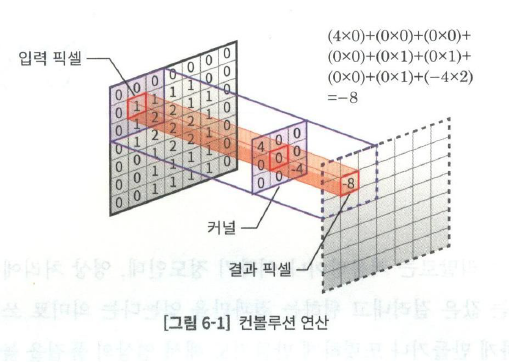

이런 식으로 커널의 크기와 값을 어떻게 하느냐에 따라 결과 영상에 필터를 적용한 효과가 달라진다.   
주변 요소 값들의 평균 값을 반영하면 전체적인 영상은 흐릿해지고 주변 요소 값들과의 차이를 반영하면 또렷해진다.   
OpenCV에서 컨볼루션 연산을 담당하는 cv2.filter2D() 함수는 6.1.2 절의 예제에서 확인해본다.


### 6.1.2 평균 블러링
영상을 초점이 맞지 않은 것처럼 흐릿하게 만드는 것을 **블러링 또는 스무딩(smoothing)**이라고 한다.  
블러링을 적용하는 가장 쉬운 방법은 주변 픽셀 값들의 평균을 적용하는 것이다. 
$$k = \frac{1}{25}\begin{bmatrix}
1 & 1 & 1 & 1 & 1\\ 
1 & 1 & 1 & 1 & 1\\ 
1 & 1 & 1 & 1 & 1\\ 
1 & 1 & 1 & 1 & 1\\ 
1 & 1 & 1 & 1 & 1
\end{bmatrix} k = \begin{bmatrix}
0.04 & 0.04 & 0.04 & 0.04 & 0.04\\ 
0.04 & 0.04 & 0.04 & 0.04 & 0.04\\ 
0.04 & 0.04 & 0.04 & 0.04 & 0.04\\ 
0.04 & 0.04 & 0.04 & 0.04 & 0.04\\ 
0.04 & 0.04 & 0.04 & 0.04 & 0.04
\end{bmatrix}$$

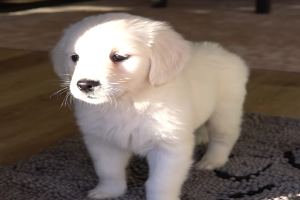

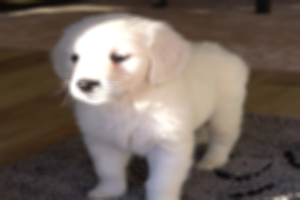

In [ ]:
# 예제 6-1 평균 필터를 생성해서 불러 적용
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG')
resize_img = cv2.resize(img, (300, 200))      #크기 조정
'''
#5x5 평균 필터 커널 생성    ---①
kernel = np.array([[0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04],
                   [0.04, 0.04, 0.04, 0.04, 0.04]])
'''
# 5x5 평균 필터 커널 생성  ---②
kernel = np.ones((5,5))/5**2          #np.ones : 모두 1로 채움, 25로 나눔.
# 필터 적용             ---③
blured = cv2.filter2D(resize_img, -1, kernel)     # 입력 영상, ddepth(출력 영상의 dtype:-1은 입력과 그대로), 컨볼루션 연산 커널

# 결과 출력
cv2_imshow(resize_img)
cv2_imshow(blured) 
cv2.waitKey()
cv2.destroyAllWindows()

OpenCV는 개발자가 직접 커널을 생성하지 않아도 평균 블러를 할 수 있게 함수를 몇 가지 더 제공한다.
다음 예제를 보고 확인해보자.

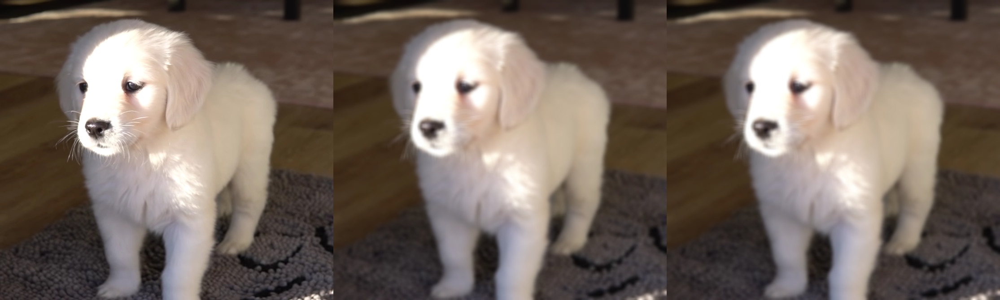

In [ ]:
# 예제 6-2 블러 전용 함수로 블러링 적용
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

file_name = '/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG'
img = cv2.imread(file_name)

# blur() 함수로 블러링  ---①
blur1 = cv2.blur(img, (10,10))            # 입력 영상, ksize 커널의 크기
# boxFilter() 함수로 블러링 적용 ---②
#ksize 배열에 normalize 인자에 False를 지정하면 커널 영역의 모든 픽셀의 합을 구하게 되는데, 
#이것은 밀도를 이용한 객체 추적 알고리즘에서 사용된다. -> 8.5.2절
blur2 = cv2.boxFilter(img, -1, (10,10))   # 입력 영상, ddepth(출력 영상의 dtype), ksize 커널의 크기

# 결과 출력
merged = np.hstack( (img, blur1, blur2))    # 배열을 왼쪽에서 오른쪽으로 붙임.
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.1.3 가우시안 블러링
- 평균이 아닌 가우시안 분포를 갖는 커널로 블러링을 하는 것.
- 중앙 값이 가장 크고, 멀어질 수록 그 값이 작아지는 커널을 사용.
$$k = \frac{1}{16}\begin{bmatrix}
1 & 2 & 1\\ 
2 & 4 & 2\\ 
1 & 2 & 1
\end{bmatrix}$$  
이렇게 하면 대상 픽셀에 가까울수록 많은 영향을 주고 멀어질수록 적은 영향을 주기 때문에 원래의 영상과 비슷하면서 노이즈를 제거하는 효과가 있다.

**#가우시안 분포(Gaussian Distribution)**  
가우시안 분포는 정규 분포(normal distribution)라고도 하며, 평균 근처에 모여 있는 값들의 개수가 많고, 평균에서 멀어질수록 그 개수가 적어지는 분포를 말한다.

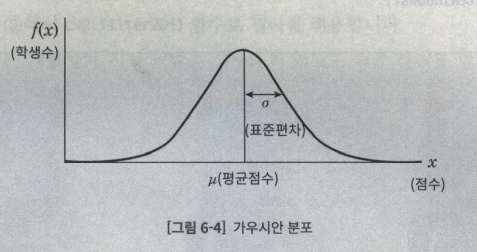

평균에서 얼마나 떨어져 있는지를 나타내는 것을 표준편차(standard deviation)라고 하며, 수식으로는 $\sigma$(sigma)라고 표현한다.  
***가우시안 함수는 이 분포를 따르는 함수이고 평균과 표준편차에 의해 결정된다.***  
OpenCV에서 가우시안 분포 커널로 블러링을 적용하는 함수를 다음 예제로 확인해본다.

k1: [[0.0625 0.125  0.0625]
 [0.125  0.25   0.125 ]
 [0.0625 0.125  0.0625]]
k2: [[0.0625 0.125  0.0625]
 [0.125  0.25   0.125 ]
 [0.0625 0.125  0.0625]]
k2(전치 안했을 경우): [[0.0625]
 [0.25  ]
 [0.0625]]


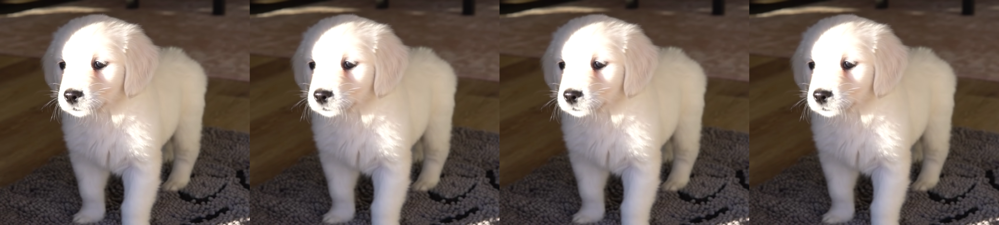

In [ ]:
# 예제 6-4 가우시안 블러
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG')

# 가우시안 커널을 직접 생성해서 블러링  ---①
k1 = np.array([[1, 2, 1],
               [2, 4, 2],
               [1, 2, 1]]) *(1/16)
blur1 = cv2.filter2D(img, -1, k1)

# 가우시안 커널을 API로 얻어서 블러링 ---②
k2 = cv2.getGaussianKernel(3, 0)            # 커널 크기와, 표준편차를 전달하면 가우시안 블러링 커널을 반환.
blur2 = cv2.filter2D(img, -1, k2*k2.T)

# 가우시안 블러 API로 블러링 ---③
blur3 = cv2.GaussianBlur(img, (3, 3), 0)    # 입력 영상, 커널 크기, sigmaX, sigmaY(표준편차):0이면 자동 선택.

# 결과 출력
print('k1:', k1)
print('k2:', k2*k2.T)                           # 행렬 곱을 하기 위해 .T 함수 사용
print('k2(전치 안했을 경우):', k2*k2)           # 전치 안했을 경우를 확인
merged = np.hstack((img, blur1, blur2, blur3))

cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.1.4 메디언 블러링
- 커널 영역 픽셀 값 중에 중간 값을 대상 픽셀의 값으로 선택하는 것을 메디언(median) 블러링이라고 함.  

미디언 블러링은 소금-후추같은 잡음 제거에 효과적이라고 하는데, OpenCV에서 제공하는 cv2.medianBlur() 함수를 예제를 통해 확인해본다.

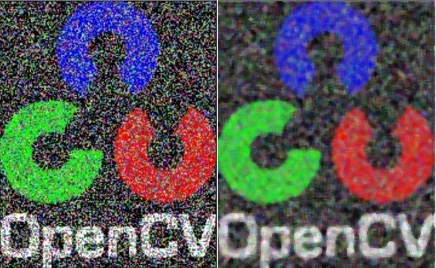

In [ ]:
# 예제 6-4 미디언 블러링
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/salt_pepper_noise.jpg")

# 미디언 블러 적용 --- ①
blur = cv2.medianBlur(img, 5)       # 입력영상, kszie

# 결과 출력 
merged = np.hstack((img,blur))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.1.5 바이레터럴 필터
블러링 필터는 대체로 잡음을 제거하는 데 효과가 있지만, edge(경계)도 흐릿하게 만드는 문제를 가지고 있다.
- 바이레터럴(bilateral) 필터 : 이러한 문제를 개선하기 위해 가우시안 필터와 경계 필터 2개를 사용.
- 노이즈는 없고 경계가 비교적 또렷한 영상을 얻을 수 있지만 속도가 느림.  

OpenCV에 cv2.bilateralFilter() 함수를 예제를 통해 확인해보자.

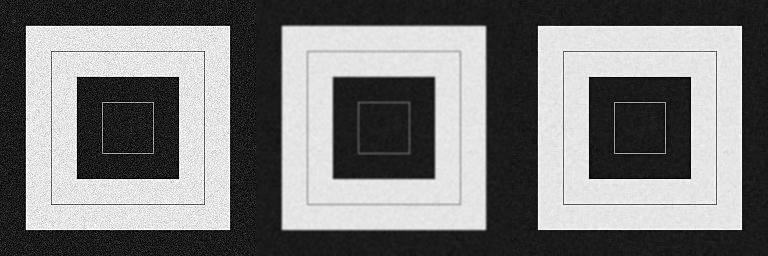

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/gaussian_noise.jpg")

# 가우시안 필터 적용 ---①
blur1 = cv2.GaussianBlur(img, (5,5), 0)

# 바이레터럴 필터 적용 ---②
# 입력 영상, 커널 직경(5보다 크면 매우 느림),sigmaColor(색공간 필터의 시그마 값), sigmaSpace(좌표 공간의 시그마 값) 
# sigmaSpace : 범위는 10~150, sigmaColor와 같은 값을 사용하는 것을 권장.
blur2 = cv2.bilateralFilter(img, 5, 75, 75)

# 결과 출력
merged = np.hstack((img, blur1, blur2))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

## 6.2 경계 검출
영상에서 경계(edge)를 검출하는 것은 배경과 전경을 분리하는 데 가장 기본적인 작업이다. 
- 경계 검출은 객체 인식과 추적의 첫 걸음에 해당하는 아주 중요한 작업임.
- Sharpening(샤프닝) : 앞서 알아본 필터들은 영상을 흐릿하게 만들었지만, 그 반대로 영상의 경계를 선명하게 만드는 것. 샤핑을 통해 경계를 검출해서 경계에 있는 픽셀을 강조한다.

### 6.2.1 기본 미분 필터
경계를 검출하기 위해서는 픽셀 값의 변화가 갑자기 크게 일어나는 지점을 찾아야 하기 때문에, 연속된 픽셀 값에 미분 연산을 한다.
$$Gx = \frac{\partial f(x,y)}{\partial x} \approx f_{x+1,y} - f_{x,y}$$
$$Gy = \frac{\partial f(x,y)}{\partial y} \approx f_{x,y+1} - f_{x,y}$$
미분 연산은 결국에는 다음 값과 현재 값의 차이를 구하는 것과 같다. 

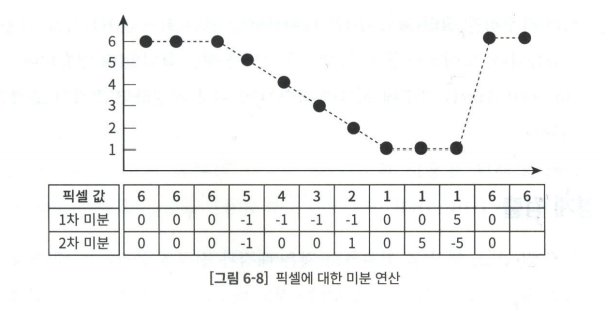

영상에 대한 미분 연산을 컨볼루션 커널로 만들면 다음과 같다.
$$Gx = \begin{bmatrix}
-1 &1
\end{bmatrix}$$
$$Gy = \begin{bmatrix}
-1\\ 
1
\end{bmatrix}$$

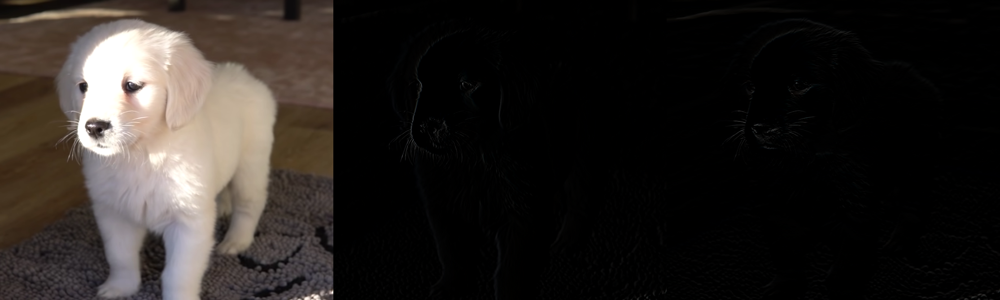

In [ ]:
# 예제 6-6 미분 커널로 경계 검출
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG")

#미분 커널 생성 ---①
gx_kernel = np.array([[ -1, 1]])
gy_kernel = np.array([[ -1],[ 1]])

# 필터 적용 ---②
edge_gx = cv2.filter2D(img, -1, gx_kernel)
edge_gy = cv2.filter2D(img, -1, gy_kernel)
# 결과 출력
merged = np.hstack((img, edge_gx, edge_gy))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

근사 값이긴 하지만 미분으로 얻은 엣지 정보는 x축과 y축에 대한 값의 변화를 나타내는 것이고, 이를 기울기, 즉 Gradient 라고 한다 
- $G_x$,$G_y$ 이 두값을 이용하면 엣지의 강도(magnitude)와 방향(direction)이라는 두 가지 중요한 정보를 추가로 얻을 수 있는데, 아래의 식이 그 방법을 설명함. 
$$magnitude = \sqrt{G^2_x + G^2_y}$$
$${direction}(\theta) = {arctan}(\frac{G_y}{G_x})$$


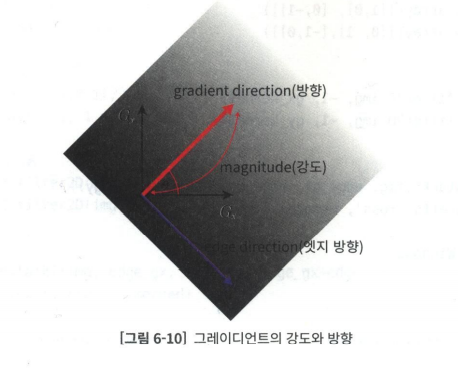

중요한 것은 이렇게 해서 얻은 gradient 방향은 엣지 방향이 아니고, 수직 관계라는 것이다. 이는 영상의 특징을 묘사하는 중요한 단서이고, 8장 '영상매칭과 추적'에서 주요 내용을 다룬다고 한다. 

### 6.2.1 로버츠 교차 필터
- 1963년 로렌스 로버츠가 기본 미분 커널을 개선한 커널을 제안
$$G_x = \begin{bmatrix}
+1 & 0\\ 
0 & -1
\end{bmatrix}$$
$$G_y = \begin{bmatrix}
+1 & 0\\ 
0 & -1
\end{bmatrix}$$
- 대각선 방향으로 배치해서 사선 경계 검출 효과를 높였지만, 노이즈에 민감하고 엣지 강도가 약한 단점이 있음.

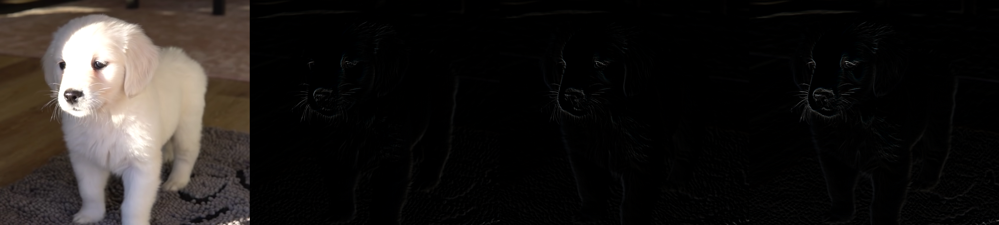

In [ ]:
# 예제 6-7 로버츠 마스크를 적용한 경계 검출
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG")

# 로버츠 커널 생성 ---①
gx_kernel = np.array([[1,0], [0,-1]])
gy_kernel = np.array([[0, 1],[-1,0]])

# 커널 적용 ---② 
edge_gx = cv2.filter2D(img, -1, gx_kernel)
edge_gy = cv2.filter2D(img, -1, gy_kernel)

# 결과 출력
merged = np.hstack((img, edge_gx, edge_gy, edge_gx+edge_gy))    # 4번째 이미지는 
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.2.3 프리윗 필터
- 주디스 프리윗이 개발한 프리윗 마스크는 각 방향으로 차분을 세 번 계산하도록 배치함.
- 엣지강도(mgnitude)가 강하고, 수직과 수평 엣지를 동등하게 찾는 장점이 있지만, 대각선 검출이 약함.  

$$G_x = \begin{bmatrix}
-1 & 0 & +1\\ 
-1 & 0 & +1\\ 
-1 & 0 & +1
\end{bmatrix}$$

$$G_y = \begin{bmatrix}
-1 & -1 & -1\\ 
0 & 0 & 0\\ 
+1 & +1 & +1
\end{bmatrix}$$

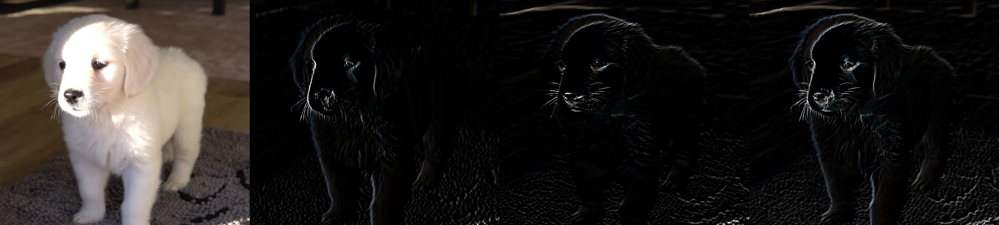

In [ ]:
# 예제 6-8 프리윗 마스크를 적용한 경계 검출
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

file_name = "/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG"
img = cv2.imread(file_name)

# 프리윗 커널 생성
gx_k = np.array([[-1,0,1], [-1,0,1],[-1,0,1]])
gy_k = np.array([[-1,-1,-1],[0,0,0], [1,1,1]])

# 프리윗 커널 필터 적용
edge_gx = cv2.filter2D(img, -1, gx_k)
edge_gy = cv2.filter2D(img, -1, gy_k)

# 결과 출력
merged = np.hstack((img, edge_gx, edge_gy, edge_gx+edge_gy))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.2.4 소벨 필터
- 1968년 어원 소벨은 중심 픽셀의 차분 비중을 두배로 주어 수평, 수직 대각선 경계 검출에 모두 강한 마스크를 제안.

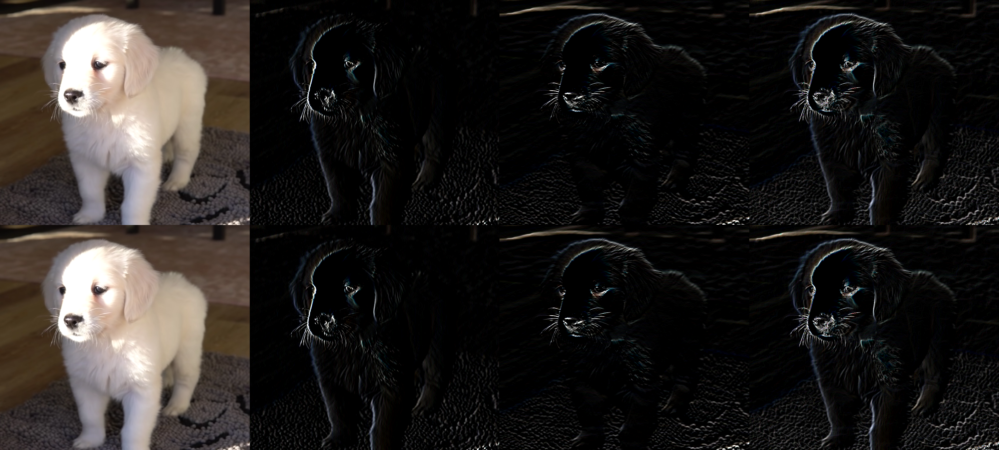

In [ ]:
# 6-9 소벨 마스크를 적용한 경계 검출
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG")

# 소벨 커널을 직접 생성해서 엣지 검출 ---①
## 소벨 커널 생성
gx_k = np.array([[-1,0,1], [-2,0,2],[-1,0,1]])
gy_k = np.array([[-1,-2,-1],[0,0,0], [1,2,1]])
## 소벨 필터 적용
edge_gx = cv2.filter2D(img, -1, gx_k)
edge_gy = cv2.filter2D(img, -1, gy_k)

# 소벨 API를 생성해서 엣지 검출
# 입력 영상, ddepth, dx, dy미분 차수(0,1,2중 선택, 둘 다 0은 안됨), ksize(1,3,5,7중 선택)
sobelx = cv2.Sobel(img, -1, 1, 0, ksize=3)    # x에 대해 1차 미분
sobely = cv2.Sobel(img, -1, 0, 1, ksize=3)    # y에 대해 1차 미분 

# 결과 출력
merged1 = np.hstack((img, edge_gx, edge_gy, edge_gx+edge_gy))   # 직접 소벨 마스크를 생성하여 필터를 적용
merged2 = np.hstack((img, sobelx, sobely, sobelx+sobely))       # cv2.Sobel() 함수 적용
merged = np.vstack((merged1, merged2))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.2.5 샤르 필터
- 소벨 필터는 커널의 크기가 작은 경우, 또는 중심에서 멀어질수록 엣지 방향성의 정확도가 떨어지는 단점이 있는데, 이를 개선한 필터.
$$G_x = \begin{bmatrix}
-3 & 0 & +3\\ 
-10 & 0 & +10\\ 
-3 & 0 & +3
\end{bmatrix}$$  
$$G_y = \begin{bmatrix}
-3 & -10 & -3\\ 
0 & 0 & 0\\ 
+3 & +10 & +3
\end{bmatrix}$$

OpenCV는 cv2.Scharr() 함수를 제공하고, ksize가 없다는 것을 제외하면 cv2.Sobel() 함수와 인자가 같다. 예제를 통해 확인해본다.


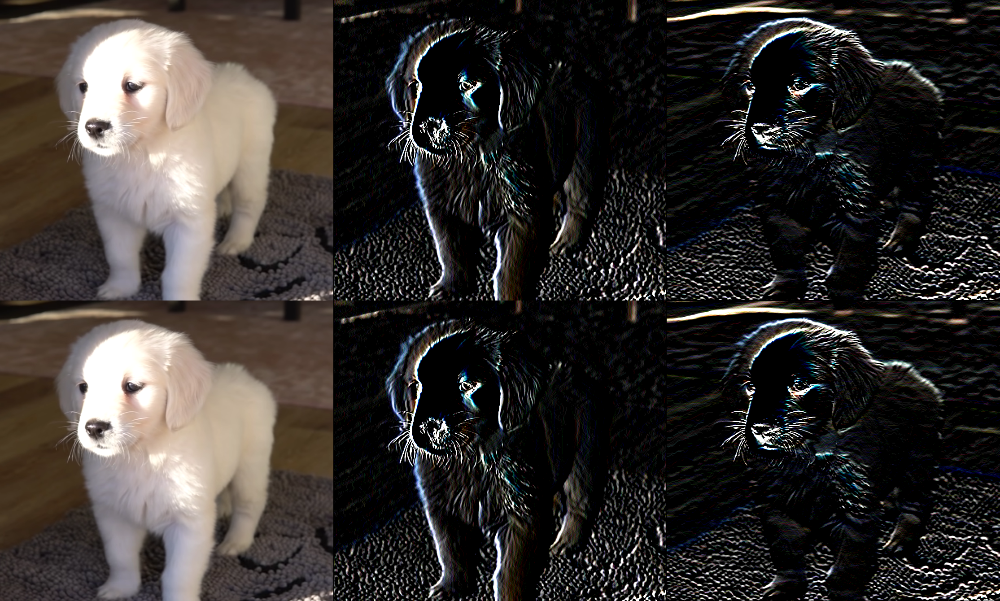

In [ ]:
# 예제 6-10 샤르 마스크를 적용한 경계 검출
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG")

# 샤르 커널을 직접 생성해서 엣지 검출 ---①
gx_k = np.array([[-3,0,3], [-10,0,10],[-3,0,3]])
gy_k = np.array([[-3,-10,-3],[0,0,0], [3,10,3]])
edge_gx = cv2.filter2D(img, -1, gx_k)
edge_gy = cv2.filter2D(img, -1, gy_k)

# 샤르 API로 엣지 검출 ---②
scharrx = cv2.Scharr(img, -1, 1, 0)     #입력영상, ddepth, dx, dy(미분차수)
scharry = cv2.Scharr(img, -1, 0, 1)

# 결과 출력
merged1 = np.hstack((img, edge_gx, edge_gy))
merged2 = np.hstack((img, scharrx, scharry))
merged = np.vstack((merged1, merged2))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.2.6 라플라시안 필터
- 한 번 미분한 결과에서 다시 미분하는 2차 미분을 적용하면 경계를 좀 더 확실히 검출할 수 있는데, 라플라시안 필터는 대표적인 2차 미분 마스크이다.  

$$\frac{\partial^2 f}{\partial y^2} = \frac{\partial f(x,y+1)}{\partial y} - \frac{\partial f(x,y)}{\partial y}$$
$$=[f(x,y+1)-f(x,y)]-[f(x,y)-f(x,y-1)]$$
$$=f(x,y+1)-2f(x,y)+f(x,y-1)$$

이 수식을 커널로 표현하면 아래와 같다.   
$$kernel = \begin{bmatrix}
0 & 1 & 0\\ 
1 & -4 & 1\\ 
0 & 1 & 0
\end{bmatrix}$$


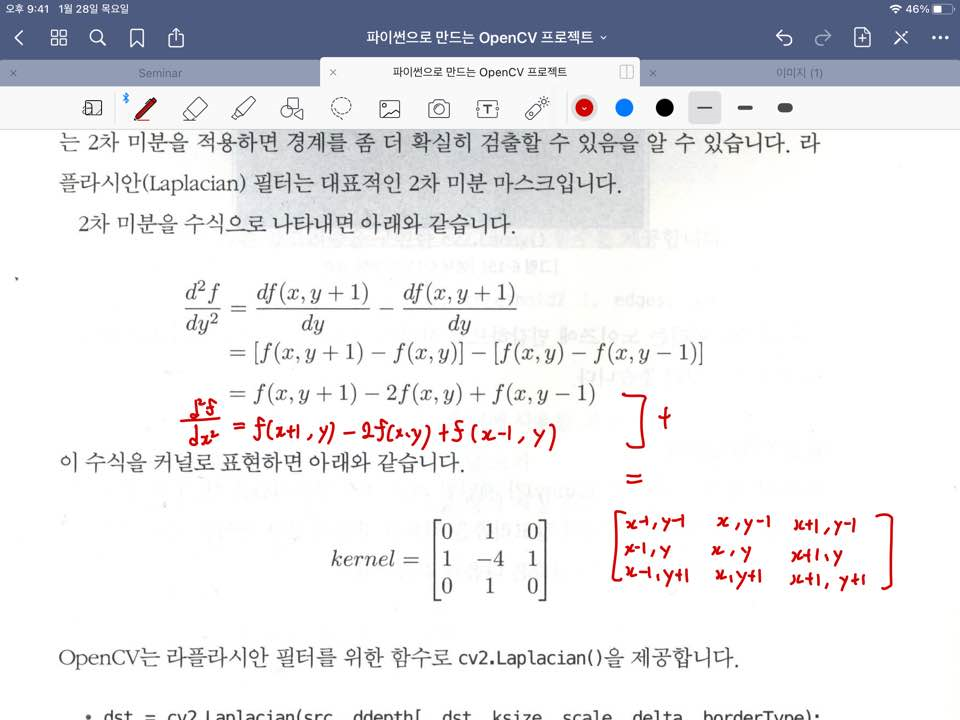

OpenCV는 이 라플라시안 필터를 위한 함수로 cv2.Laplacian()을 제공한다. 다음 예제로 확인해보자.

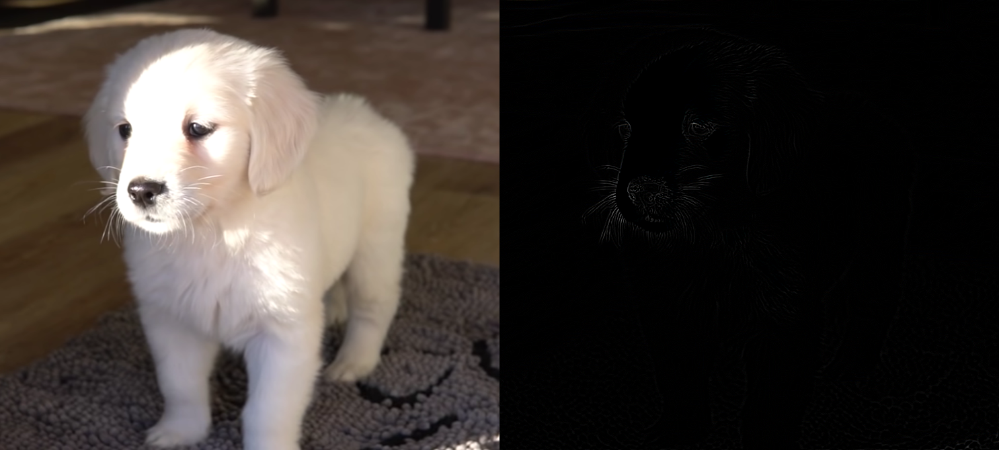

In [ ]:
# 예제 6-11 라플라시안 마스크를 적용한 경계 검출
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG")

# 라플라시안 필터 적용 ---①
edge = cv2.Laplacian(img, -1)       # 입력 영상, ddepth

# 결과 출력
merged = np.hstack((img, edge))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.2.7 캐니 엣지
캐니 엣지 알고리즘은 한 가지 필터를 사용하는 것이 아니라 4단계의 알고리즘을 적용한 잡음에 강한 뛰어난 엣지 검출기이다. 캐니 엣지 4단계 알고리즘은 다음과 같다.
1. 노이즈 제거(Noise Reduction) : 5$\times$5 가우시안 블러링 필터로 노이즈를 제거함.
2. 엣지 그레디언트 방향 계산 : 소벨 마스크로 엣지 및 그레디언트 방향을 검출
3. 비최대치 억제(Non-Maximum Suppression) : 그레디언트 방향에서 검출된 엣지 중에 가장 큰 값만 선택하고 나머지는 제거
4. 이력 스레시홀딩(Hysteresis Thresholding) : 두 개의 경계 값(Max, Min)을 지정해서 경계 영역에 있는 픽셀들 중 큰 경계 값(Max) 밖의 픽셀과 연결성이 없는 픽셀을 제거  

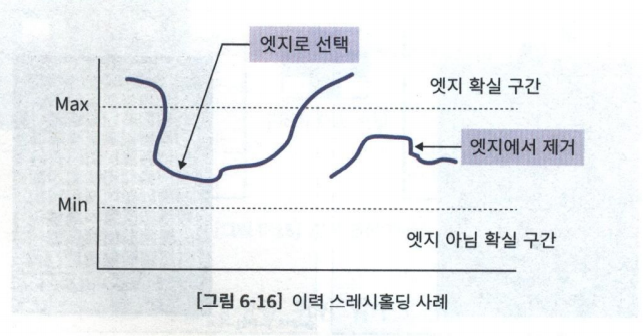

OpenCV에서 이 알고리즘을 구현한 cv2.Canny()함수를 예제를 통해 확인해본다. 

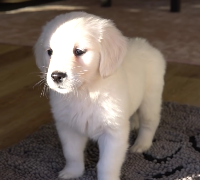

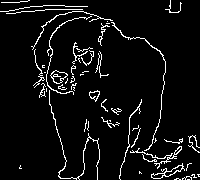

In [ ]:
# 예제 6-12 캐니 엣지 검출
import cv2, time
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG")
resize_img = cv2.resize(img, (200, 180))
# 케니 엣지 적용 
edges = cv2.Canny(resize_img,100,200)   # 입력 영상, threshold1, threshold2(이력 스레시홀딩에 사용할 최소, 최대 값))

# 결과 출력
cv2_imshow(resize_img)
cv2_imshow(edges)
cv2.waitKey(0)
cv2.destroyAllWindows()

## 6.3 모폴로지(morphology) 
모폴로지는 형태학이란 뜻으로 영상 분야에서는 영상에서 형태학적 관점에서의 영상 연산을 말한다. 그 예로 노이즈 제거,구멍 메꾸기, 연결되지 않은 경계 이어붙이기 등이 있다.  
- 주로 형태를 다루는 연산이므로 바이너리 이미지를 대상으로 함.
- 대표적인 연산으로 침식과 팽창이며, 이 둘을 결합한 열림과 닫힘이 있다. 

### 6.3.1 침식 연산
침식(erosion)은 원래 있던 객체의 영역을 깍아 내린 연산이다. 이 연산을 위해 **구조화 요소(structuring element)**라는 0과 1로 채워진 커널이 필요하다.
- 구조화 요소 : 1이 채워진 모양에 따라 사각형, 타원형, 십자형 등을 사용할 수 있다. 

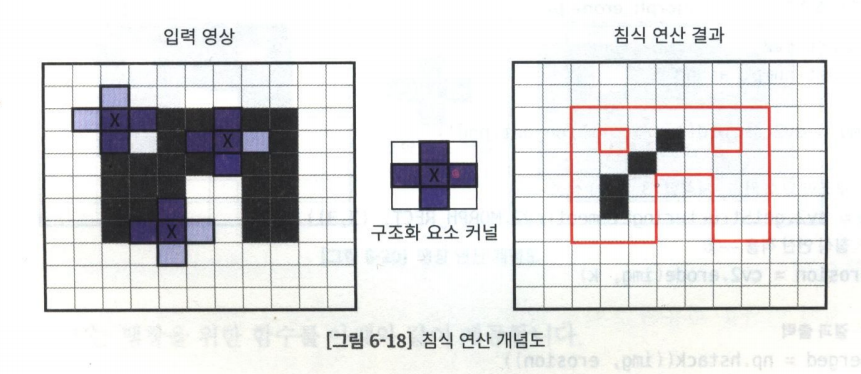

OpenCV는 구조화 요소 커널 생성을 위한 함수로 cv2.getStructuringElement()가 있는데, 예제로 확인해보자.

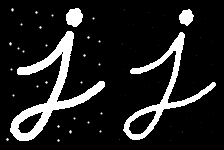

In [ ]:
# 예제 6-13 침식 연산
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/morph_dot.png')

# 구조화 요소 커널, 사각형 (3x3) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))      # shape(구조화 요소 커널의 모양 결정), ksize
# 침식 연산 적용 ---②
erosion = cv2.erode(img, k)     # 입력 영상, 구조화 요소 커널 객체

# 결과 출력
merged = np.hstack((img, erosion))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

cv2.getStructuringElement() 함수의 shape으로는 다음 요소가 있다.
- cv2.MORPH_RECT : 사각형(rectangle)
- cv2.MORPH_ELLIPSE : 타원형
- cv2.MORPH_CROSS : 십자형  

침식 연산은 작은 객체는 아예 사라지게 만들 수 있으므로 아주 작은 노이즈를 제거할 때 좋다.

### 6.3.2 팽창 연산
팽창(dilatation)은 침식과 반대로 영상 속 사물의 줍ㄴ을 덧붙여서 영역을 더 확장하는 연산이다. **구조화 요소 커널을 입력 영상에 적용해서 1로 채워진 영역이 완전히 덮이지 않으면 1로 채워 넣는다.**  
OpenCV에서 팽창을 위한 함수는 cv2.dilate()이고, 예제를 통해 확인한다.

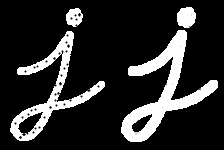

In [ ]:
# 예제 6-14 팽창 연산
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/morph_hole.png')

# 구조화 요소 커널, 사각형 (3x3) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
# 팽창 연산 적용 ---②
dst = cv2.dilate(img, k)

# 결과 출력
merged = np.hstack((img, dst))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

### 6.3.3 열림과 닫힘, 그밖의 모폴로지 연산
- 앞서 결과를 봤듯이 침식과 팽창 연산은 밝은 부분이나 어두운 부분의 점 노이즈를 제거하는데 효과적, 하지만 원래의 모양이 홀쭉해지거나 뚱뚱해지는 변형이 일어남.
- 그러나, 침식과 팽창 연산을 조합하면 원래의 모양을 유지하고, 노이즈만 제거할 수 있음.

- 열림(opening) 연산 : 침식 연산을 적용하고 나서 팽창 연산을 적용하는 것
  - 주변보다 밝은 노이즈 제거에 효과적이고, 맞닿아 있는 것으로 보이는 독립된 개체를 분리하거나 돌출된 픽셀을 제거하는 데 좋음
- 닫힘(closing) 연산 : 팽창 연산을 먼저 적용하고 침식 연산을 적용하는 것
  - 주변보다 어두운 노이즈 제거에 효과적이면서 끊어져 보이는 개체를 연결하거나 구멍을 메우는 데 좋음

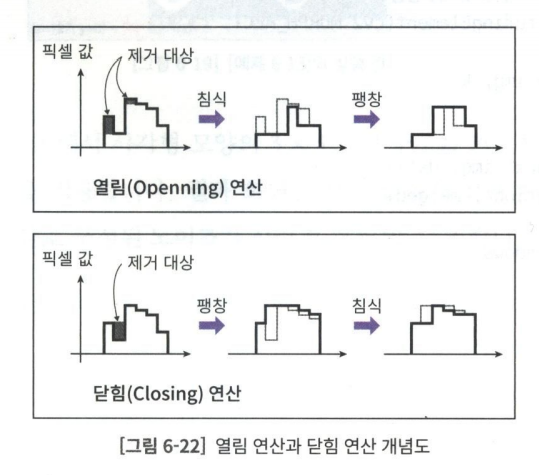

- 그레디언트(gradient) 연산 : 팽창한 결과에서 침식한 결과를 빼면 경계만 얻게 되는데, 앞서 살펴본 경계 검출과 비슷한 결과를 얻을 수 있음
- 탑 햇(top hat) : 원본에서 열림 연산 결과를 빼면 밝기 값이 크게 튀는 영역을 강조함
- 블랙햇(black hat) : 닫힘 연산 결과에서 원본을 빼면 어두운 부분을 강조함  

OpenCV는 이러한 연산들을 사용할 수 있도록 cv2.morphologyEx() 함수를 제공하는데 예제를 통해 확인해본다.

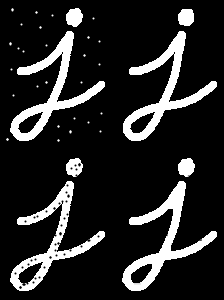

In [ ]:
# 예제 6-15 열림과 닫힘 연산으로 노이즈 제거
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img1 = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/morph_dot.png', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/morph_hole.png', cv2.IMREAD_GRAYSCALE)    

# 구조화 요소 커널, 사각형 (5x5) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
# 열림 연산 적용 ---②
opening = cv2.morphologyEx(img1, cv2.MORPH_OPEN, k)     # 입력 영상, 모폴로지 연산 종류 지정, 구조화 요소 커널
# 닫힘 연산 적용 ---③
closing = cv2.morphologyEx(img2, cv2.MORPH_CLOSE, k)

# 결과 출력
merged1 = np.hstack((img1, opening))
merged2 = np.hstack((img2, closing))
merged3 = np.vstack((merged1, merged2))
cv2_imshow(merged3)
cv2.waitKey(0)
cv2.destroyAllWindows()

모폴로지 연산 종류 요소
- cv2.MORPH_OPEN : 열림 연산
- cv2.MORPH_CLOSE : 닫힘 연산
- cv2.MORPH_GRADIENT : 그레디언트 연산
- cv2.MORPH_TOPHAT : 탑햇 연산
- cv2.MORPH_BLACKHAT : 블랙햇 연산

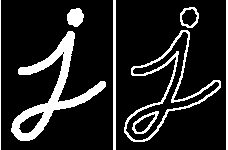

In [ ]:
# 예제 6-16 모폴로지 그레디언트
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/morphological.png')

# 구조화 요소 커널, 사각형 (3x3) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
# 열림 연산 적용 ---②
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, k)

# 결과 출력
merged = np.hstack((img, gradient))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

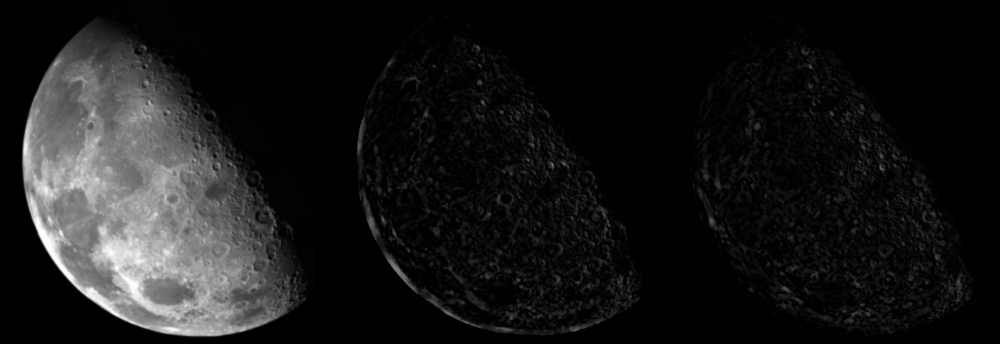

In [ ]:
# 예제 6-17 모폴로지 탑햇, 블랙햇 연산
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/moon_gray.jpg')

# 구조화 요소 커널, 사각형 (9x9) 생성 ---①
k = cv2.getStructuringElement(cv2.MORPH_RECT, (9,9))
# 탑햇 연산 적용 ---②
tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, k)
# 블랫햇 연산 적용 ---③
blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, k)

# 결과 출력
merged = np.hstack((img, tophat, blackhat))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

## 6.4 이미지 피라미드


- 이미지 피라미드(image pyramids)는 영상의 크기를 단계적으로 축소 또는 확대해서 피라미드처럼 쌓아 놓는 것. 
- 작은 이미지로 빠르게 훑고, 다음 단계 크기의 영상으로 분석하는 식으로 정확도를 높임.
- 영상의 크기에 따라 분석하는 내용이 다를 수 있음.

### 6.4.1 가우시안 피라미드
- 가우시안 필터를 적용한 후에 이미지 피라미드를 구현하는 것.  

OpenCV에서 cv2.pyrDown(), cv2.pyrUp() 이라는 함수를 제공한다.  
- cv2.pyrDown()는 모든 짝수 행과 열을 삭제해서 입력 영상의 $\frac{1}{4}$ 크기로 축소 
- cv2.pyrUp()는 0으로 채워진 짝수 행과 열을 새롭게 삽입하고 나서 가우시안 필터로 컨볼루션을 수행해서 주변 픽셀과 비슷하게 만드는 방법으로 4배 확대  

예제를 통해 확인해 본다.

img


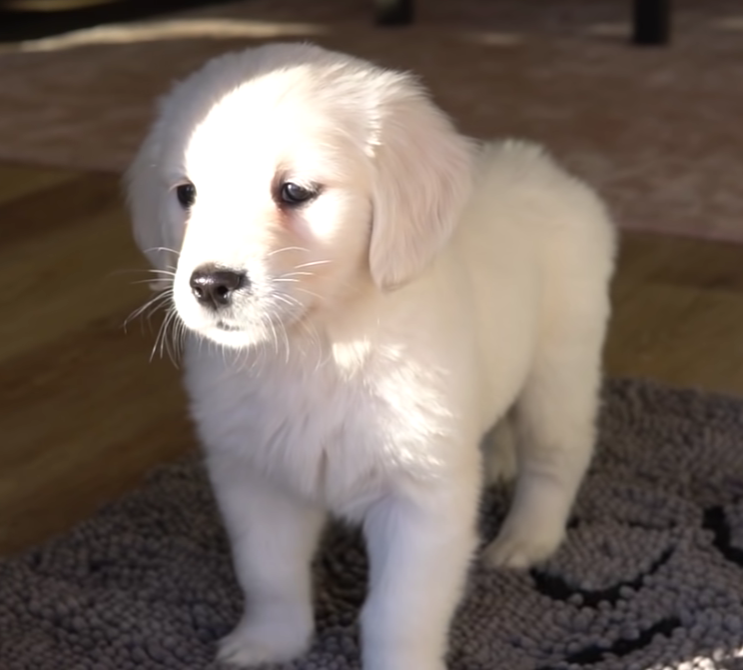

smaller


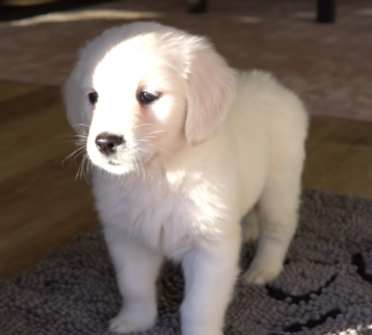

bigger


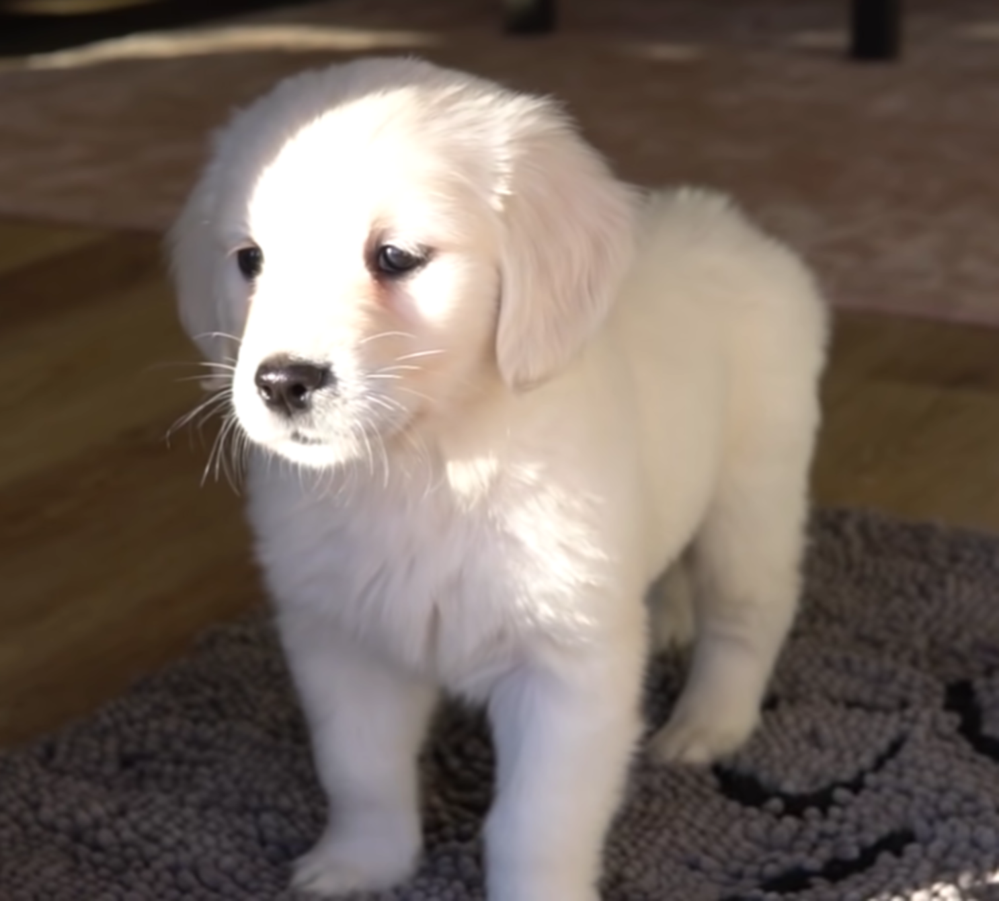

In [ ]:
# 가우시안 이미지 피라미드
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/강아지 캡처.PNG")

# 가우시안 이미지 피라미드 축소
smaller = cv2.pyrDown(img) # 입력영상
# 가우시안 이미지 피라미드 확대
bigger = cv2.pyrUp(img) # 입력영상

# 결과 출력
print("img")
cv2_imshow(img)
print("smaller")
cv2_imshow(smaller)
print("bigger")
cv2_imshow(bigger)

### 6.4.2 라플라시안 피라미드
- cv2.pyrUp() 함수는 4배로 확대할 때 없던 행과 열을 생성해서 가우시안 필터를 적용  
- cv2.pyrDown()으로 한 단계 작아진 영상을 cv2.pyrUp()으로 확대해도 원래 영상을 완벽히 복원할 수 없음  
- 원본 영상에서 cv2.pyrUp()으로 확대한 영상을 빼면 원본과 확대본의 차이가 되는데, 이를 보관해 두었다가 확대 영상에 더하면 원본을 완벽히 복원할 수 있음  
- **원본과 cv2.pyrUp() 함수를 적용한 영상의 차이를 단계별로 모아두는 것을 라플라시안 피라미드라고 함**

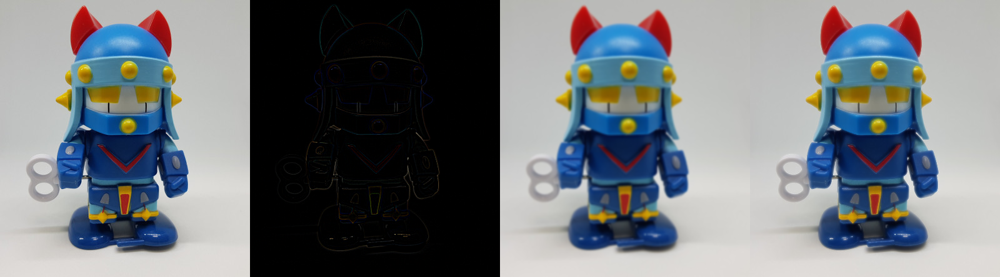

In [ ]:
# 예제 6-19 라플라시안 피라미드로 영상 복원
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/drive/MyDrive/파이썬을 이용한 open CV/Data_Folder/taekwonv1.jpg')

# 원본 영상을 가우시안 피라미드로 축소
smaller = cv2.pyrDown(img)
# 축소한 영상을 가우시안 피라미드로 확대
bigger = cv2.pyrUp(smaller)

# 원본에서 확대한 영상 빼기 (0으로 채운 부분)
laplacian = cv2.subtract(img, bigger)
# 확대 한 영상에 라플라시안 영상 더해서 복원
restored = bigger + laplacian

# 결과 출력 (원본 영상, 라플라시안, 확대 영상, 복원 영상)
merged = np.hstack((img, laplacian, bigger, restored))
cv2_imshow(merged)
cv2.waitKey(0)
cv2.destroyAllWindows()

위 결과를 보면 라플라시안 피라미드 영상은 대부분 0으로 채워져 있고, 가우시안 필터를 적용했기 때문에 경계 부분만 남아있는 것을 알 수 있다. 이처럼 라플라시안 피라미드는 영상의 복원의 목적뿐만 아니라 경계 검출에도 활용할 수 있다. 

## 6.5 실전 워크숍

### 6.5.1 모자이크 처리 2
5장에서 특정 영역을 축소한 뒤 다시 확대하는 방식으로 모자이크 처리를 해보았는데, 이번에는 필터를 이용해서 선택 영역을 모자이크 처리해본다.

In [ ]:
# 예제 6-20 블러링으로 모자이크 처리 풀이 결과 -> 쥬피터에서 불가능
import cv2

ksize = 30              # 블러 처리에 사용할 커널 크기
win_title = 'mosaic'    # 창 제목
img = cv2.imread('../img/taekwonv1.jpg')    # 이미지 읽기

while True:
    x,y,w,h = cv2.selectROI(win_title, img, False) # 관심영역 선택
    if w > 0 and h > 0:         # 폭과 높이가 음수이면 드래그 방향이 옳음 
        roi = img[y:y+h, x:x+w]   # 관심영역 지정
        roi = cv2.blur(roi, (ksize, ksize)) # 블러(모자이크) 처리
        img[y:y+h, x:x+w] = roi   # 원본 이미지에 적용
        cv2.imshow(win_title, img)
    else:
        break
cv2.destroyAllWindows()

### 6.5.2 스케치 효과 카메라
카메라 영상을 스케치한 그림처럼 보여주는 카메라를 만들어보자.

In [ ]:
# 예제 6-21 스케치 효과 카메라 풀이
import cv2
import numpy as np

# 카메라 장치 연결
cap = cv2.VideoCapture(0)   
while cap.isOpened():
    # 프레임 읽기
    ret, frame = cap.read()
    # 속도 향상을 위해 영상크기를 절반으로 축소
    frame = cv2.resize(frame, None, fx=0.5, fy=0.5, \
                        interpolation=cv2.INTER_AREA)
    if cv2.waitKey(1) == 27: # esc키로 종료
        break
    # 그레이 스케일로 변경    
    img_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    # 잡음 제거를 위해 가우시안 플러 필터 적용(라플라시안 필터 적용 전에 필수)
    img_gray = cv2.GaussianBlur(img_gray, (9,9), 0)
    # 라플라시안 필터로 엣지 거출
    edges = cv2.Laplacian(img_gray, -1, None, 5)
    # 스레시홀드로 경계 값 만 남기고 제거하면서 화면 반전(흰 바탕 검은 선)
    ret, sketch = cv2.threshold(edges, 70, 255, cv2.THRESH_BINARY_INV)
    
    # 경계선 강조를 위해 팽창 연산
    kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (3,3))
    sketch = cv2.erode(sketch, kernel)
    # 경계선 자연스럽게 하기 위해 미디언 블러 필터 적용
    sketch = cv2.medianBlur(sketch, 5)
    # 그레이 스케일에서 BGR 컬러 스케일로 변경
    img_sketch = cv2.cvtColor(sketch, cv2.COLOR_GRAY2BGR)

    # 컬러 이미지 선명선을 없애기 위해 평균 블러 필터 적용
    img_paint = cv2.blur(frame, (10,10) )
    # 컬러 영상과 스케치 영상과 합성
    img_paint = cv2.bitwise_and(img_paint, img_paint, mask=sketch)
    
    # 결과 출력
    merged = np.hstack((img_sketch, img_paint))
    cv2.imshow('Sketch Camera', merged)
    
cap.release()
cv2.destroyAllWindows()